In [1]:
# Importation des librairies
from netCDF4 import Dataset
import numpy as np
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import pylab as p
import itertools
import matplotlib.gridspec as gridspec
import matplotlib.patheffects as PathEffects
from sklearn.linear_model import LinearRegression
import sys
# insert at 1, 0 is the script path (or '' in REPL)
#sys.path.insert(1, '../Climate')
#from ClimateFuns import *
from ERA_Fields import*


        
    
K = 273.15
Model = 'ERA5'
area = 'Scandinavia'
dataset = Dataset('Data_ERA5/ERA5_t2m_1979.nc')
lon = dataset.variables["longitude"][:]
lat = dataset.variables["latitude"][:]
LON, LAT = np.meshgrid(lon, lat)
dataset.close()


convseq = np.zeros(14) # convolution to be used for running mean
convseq[range(1,14,3)] = 1/5

Months1 = [0, 0, 31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]
Tot_Mon1 = list(itertools.accumulate(Months1))

""" # IF RUNNING FOR THE FIRST TIME (for detrending)
t2m = Field('t2m','t2m','Temperature',(71, 365, LON.shape[0],LON.shape[1]), 1950,'')
zg500 = Field('z','zg500','500 mbar Geopotential',(71, 365, LON.shape[0],LON.shape[1]), 1950,'')
"""

lon_start = 0
lon_end = LON.shape[1]
lat_start = 0 # latitudes start from 90 degrees North Pole
lat_end = 60*LON.shape[0]//180



lon = lon[lon_start:lon_end]
lat = lat[lat_start:lat_end]
LON, LAT = np.meshgrid(lon, lat)

t2m = Field('t2m','t2m','Temperature',Model,(71, Tot_Mon1[10]-Tot_Mon1[5], LON.shape[0],LON.shape[1]), 1950,'', Tot_Mon1[5], Tot_Mon1[10], lat_start, lat_end, lon_start, lon_end)
zg500 = Field('z','zg500','500 mbar Geopotential',Model,(71, Tot_Mon1[10]-Tot_Mon1[5], LON.shape[0],LON.shape[1]), 1950,'', Tot_Mon1[5], Tot_Mon1[10], lat_start, lat_end, lon_start, lon_end)

for y in range(t2m.var.shape[0]):
    t2m.add_year(y)
    zg500.add_year(y)

zg500.var = zg500.var/9.81 # Normalizing geopotential to geopotential height

Months1 = [0, 0, 0, 0, 0, 0, 31, 30, 31, 31, 30, 0, 0, 0]  # REMOVE THIS IF RUNNING FOR THE FIRST TIME!
Tot_Mon1 = list(itertools.accumulate(Months1))

Trying to import basemap
Successfully imported basemap
Loading field t2m, year  0 , dataset.variables[t2m].shape =  (365, 241, 480)
Loading field z, year  0 , dataset.variables[z].shape =  (365, 241, 480)
Loading field t2m, year  1 , dataset.variables[t2m].shape =  (365, 241, 480)
Loading field z, year  1 , dataset.variables[z].shape =  (365, 241, 480)
Loading field t2m, year  2 , dataset.variables[t2m].shape =  (366, 241, 480)
Loading field z, year  2 , dataset.variables[z].shape =  (366, 241, 480)
Loading field t2m, year  3 , dataset.variables[t2m].shape =  (365, 241, 480)
Loading field z, year  3 , dataset.variables[z].shape =  (365, 241, 480)
Loading field t2m, year  4 , dataset.variables[t2m].shape =  (365, 241, 480)
Loading field z, year  4 , dataset.variables[z].shape =  (365, 241, 480)
Loading field t2m, year  5 , dataset.variables[t2m].shape =  (365, 241, 480)
Loading field z, year  5 , dataset.variables[z].shape =  (365, 241, 480)
Loading field t2m, year  6 , dataset.variable

/tmp/ipykernel_3945188/71141232.py:18: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(width=coords[2],height=coords[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords[0],lon_0=coords[1])


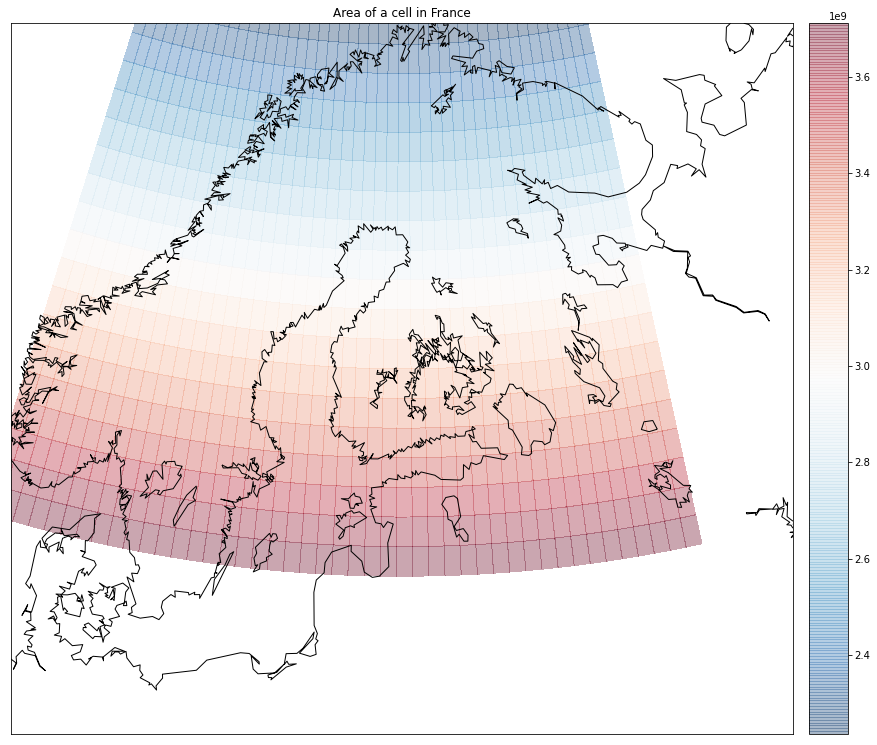

In [2]:
LON_mask = create_mask(Model,area,LON)
LAT_mask = create_mask(Model,area,LAT)
dataset = Dataset('Data_ERA5/Land-sea_mask.nc')
lsm = dataset.variables['lsm'][0]
dataset.close()

dataset = Dataset('Data_ERA5/ERA5_area.nc')
cell_area = dataset.variables["cell_area"][:]

dataset.close()
mask_ocean = np.array(lsm)
mask_area = np.array(create_mask(Model,area, lsm))
np.save("ERA5/mask_" + area, mask_area)
np.save("ERA5/mask_ocean", mask_ocean)

coords = [62, 25., 2200000, 2000000]
fig = plt.figure(figsize=(15, 15), edgecolor='w')
m = Basemap(width=coords[2],height=coords[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords[0],lon_0=coords[1])
m.pcolormesh((LON_mask), (LAT_mask), (create_mask(Model,area,cell_area)), latlon=True, alpha = .35, cmap='RdBu_r')
plt.title("Area of a cell in France")
m.colorbar()
m.drawcoastlines()
plt.show()

/tmp/ipykernel_3945188/2176751693.py:5: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(width=coords[2],height=coords[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords[0],lon_0=coords[1])


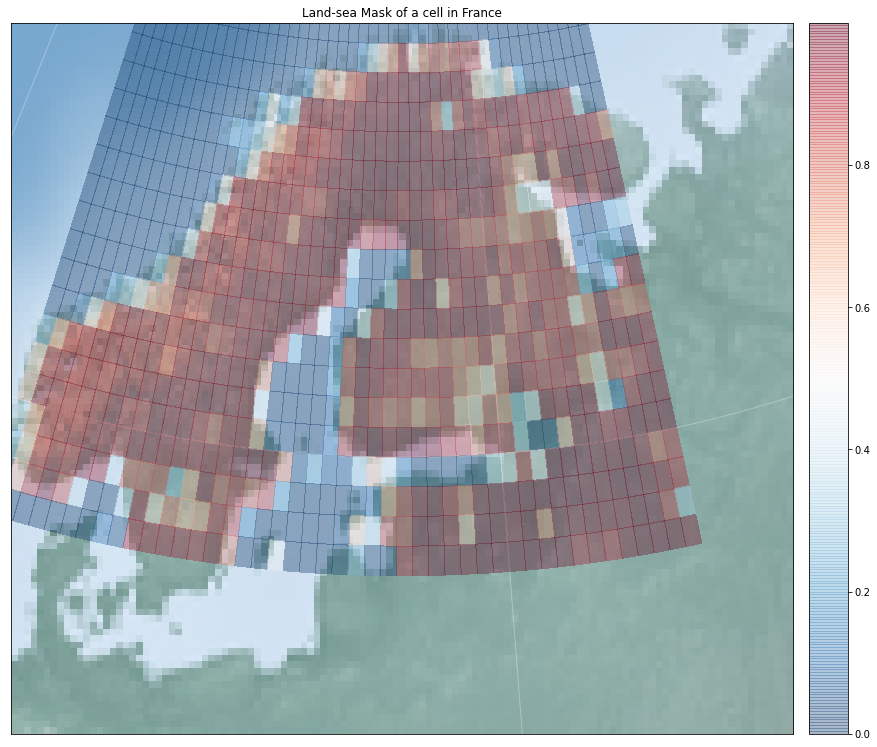

In [3]:
from itertools import chain

fig = plt.figure(figsize=(15, 15), edgecolor='w')
#m = Basemap(projection='nplaea',boundinglat=25,lon_0=0,resolution='c')
m = Basemap(width=coords[2],height=coords[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords[0],lon_0=coords[1])
draw_map(m)
m.pcolormesh((LON_mask), (LAT_mask), (create_mask(Model,area,lsm)), latlon=True, alpha = .35, cmap='RdBu_r')
plt.title("Land-sea Mask of a cell in France")
m.colorbar()
plt.show()

/tmp/ipykernel_3945188/131679500.py:7: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(width=coords2[2],height=coords2[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords2[0],lon_0=coords2[1])


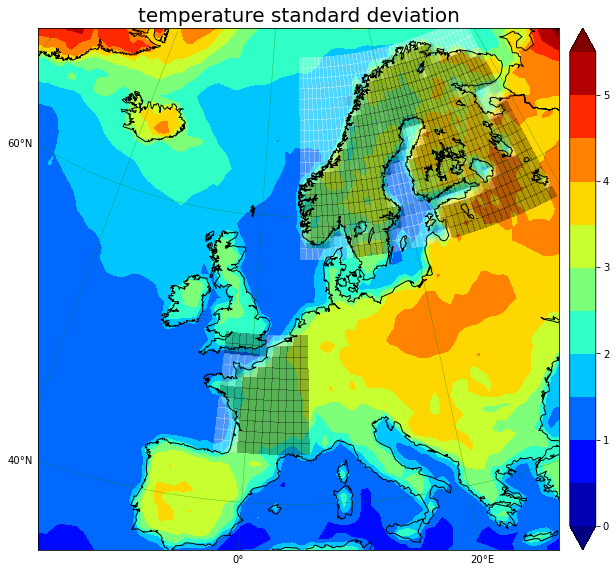

In [4]:
area = 'Scandinavia'
LON_mask = create_mask(Model,area,LON)
LAT_mask = create_mask(Model,area,LAT)
fig = plt.figure(figsize=(10, 10))
ax = plt.subplot(111)
coords2 = [55, 5., 4000000, 4000000]
m = Basemap(width=coords2[2],height=coords2[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords2[0],lon_0=coords2[1])
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(np.std(t2m.var[:,0,:,:],0)), np.arange(0,6,.5), "jet", "temperature standard deviation")
m.pcolormesh((LON_mask), (LAT_mask), (create_mask(Model,area,lsm)), latlon=True, alpha = .3, cmap='binary')
area2 = 'France'
LON_mask2 = create_mask(Model,area2,LON)
LAT_mask2 = create_mask(Model,area2,LAT)
m.pcolormesh((LON_mask2), (LAT_mask2), (create_mask(Model,area2,lsm)), latlon=True, alpha = .3, cmap='binary')
fig.savefig("Images/t2m_std.png")

In [5]:
mask = create_mask(Model,area,cell_area)*create_mask(Model,area,lsm)  
mask = mask/np.sum(np.sum(mask))  # Here I combine both grid-point area times the mask into a normalized mask
print(mask[-1,:])

[0.0 0.0 0.0 0.0 0.0003381594480298172 0.0006586455282851186
 0.0018642868580350809 0.00036515948789948995 0.0 7.447820760045128e-05
 0.002013783949879177 0.0018423556616953777 0.0019913458691864813
 0.001987966640166487 0.0021388492159087912 0.0011093670949706065
 0.00020937703007822164 0.00017075244237979976 0.00042304568101182016 0.0
 0.0 0.00019873245866526904 0.0019645823753482116 0.002208900633493067
 0.0014401260314466612 0.0013536515608252643 0.002090086941150421
 0.002204946935539673 0.0021903148738831603 0.0021491896567099413
 0.0022074137727242683 0.0021887604285339424 0.0021898079895301664
 0.0021702760457946294 0.002168451262123842 0.002183624000423591
 0.002087011842742229 0.001869761209047443 0.0022027166443865103
 0.0022136653464112275 0.002210252325101071 0.0021968029936015204
 0.002103705234100953 0.0021046176259363527 0.002210083363650063
 0.0021996415459782895]


In [6]:
Tot_Mon1[5:9]

[0, 31, 61, 92]

mylon =  30.0 , mylat =  63.75 , mylon_coor =  3221934.201390013 , mylat_coor =  3189118.7190666026


/tmp/ipykernel_3945188/389170736.py:19: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(projection='nplaea',boundinglat=30,lon_0=0,resolution='c')


i: 0
i: 31
i: 61
i: 92


<Figure size 2880x2880 with 0 Axes>

<Figure size 2880x2880 with 0 Axes>

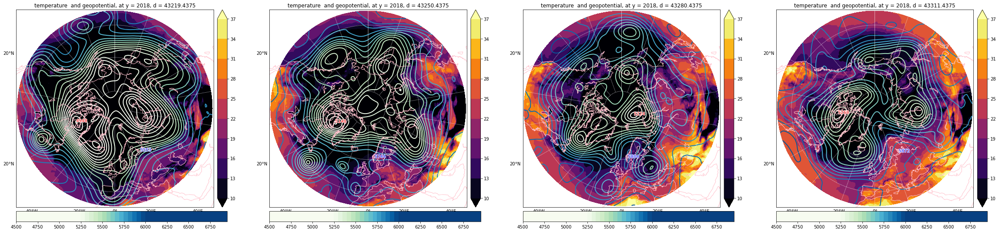

<Figure size 2880x2880 with 0 Axes>

In [7]:
y = 2018- t2m.start_year
mylon_pixel = 40
mylat_pixel = 35
mylon = LON[mylat_pixel, mylon_pixel]
mylat = LAT[mylat_pixel, mylon_pixel]
mylon_coor, mylat_coor = m(mylon, mylat)
print("mylon = ",mylon,", mylat = ",mylat, ", mylon_coor = ",mylon_coor, ", mylat_coor = ", mylat_coor)


t2m.levels = np.arange(10, 40, 3) # Levels to be used when plotting
zg500.levels = np.arange(4500, 7000, 50)
fig2 = plt.figure(figsize=(40, 40))
spec2 = gridspec.GridSpec(ncols=4, nrows=1, figure=fig2)
iterate = 0
fig2 = plt.figure(figsize=(40, 40))
for i,subplt in zip(Tot_Mon1[5:9],['141','142','143','144']):
    ax = fig2.add_subplot(spec2[0,iterate])
    iterate = iterate + 1
    m = Basemap(projection='nplaea',boundinglat=30,lon_0=0,resolution='c')
    absolute_animate(i,m, ax, 0, 0, Greenwich(LON), Greenwich(LAT), t2m.Greenwich(y,i) - K, t2m.levels, zg500.Greenwich(y,i), zg500.levels, "inferno", "temperature  and geopotential, at y = " + str(y+t2m.start_year)+", d = "+str(t2m.time[y,i]))
plt.figure(figsize=(40,40))

In [8]:
t2m.abs_area_int, t2m.ano_area_int = t2m.Set_area_integral(area,mask)
zg500.abs_area_int, zg500.ano_area_int = zg500.Set_area_integral(area,mask)

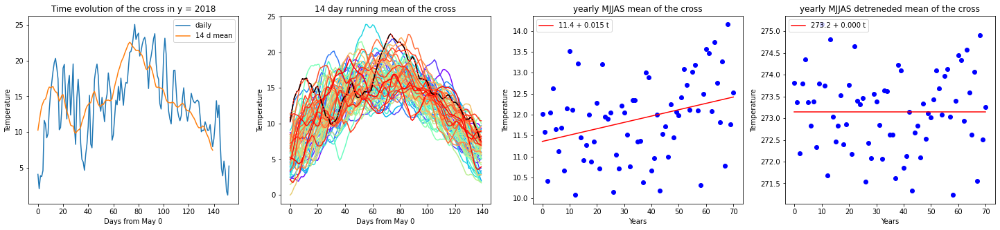

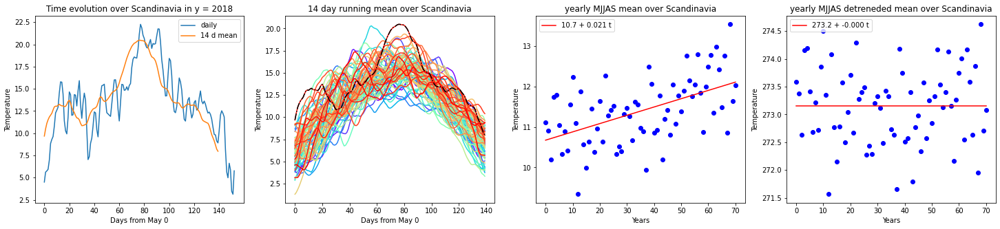

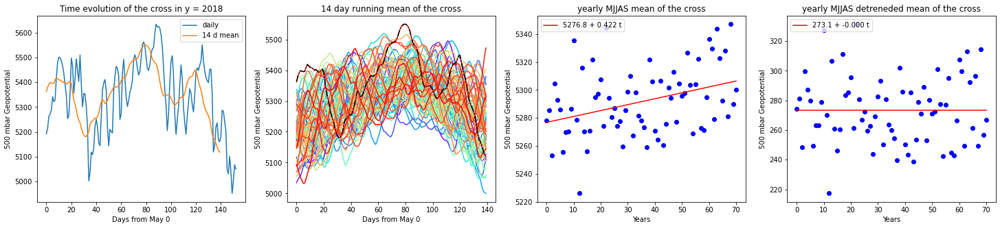

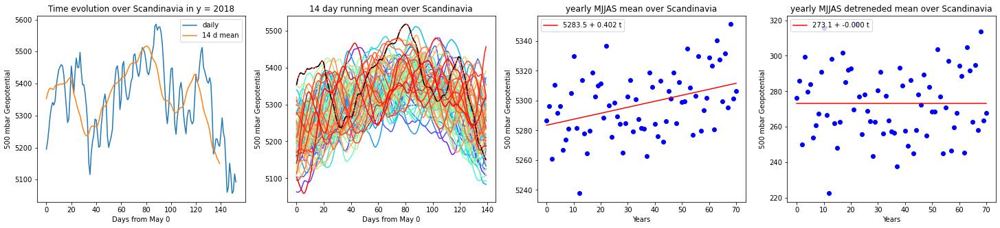

In [9]:
K = 273.15
for myfield in [t2m,zg500]:
    # Extract the field at a given pixel
    field_extract = myfield.var[:,Tot_Mon1[5]:Tot_Mon1[10],mylat_pixel,mylon_pixel]
    for j in range(2):
        y = 2018 - myfield.start_year
        if j == 0:
            objct = "of the cross"
        if j == 1:
            field_extract = myfield.abs_area_int[:,Tot_Mon1[5]:Tot_Mon1[10]]
            objct = "over "+area
        plt.figure(figsize=(25,5))
        plt.subplot(141)
        plt.plot(field_extract[y]-K,label = 'daily')
        plt.plot(np.convolve(field_extract[y]-K, np.ones(14)/14, mode='valid'),label = '14 d mean')
        plt.title('Time evolution '+objct+' in y = '+str(y+myfield.start_year))
        plt.xlabel('Days from May 0')
        plt.ylabel(myfield.label)
        plt.legend(loc='best')

        color_idx = np.linspace(0, 1, t2m.var.shape[0])
        plt.subplot(142)
        summ_mean = []
        for y in range(t2m.var.shape[0]):
            plt.plot(np.convolve(field_extract[y]-K, np.ones(14)/14, mode='valid'),color=plt.cm.rainbow(color_idx[y]))
            summ_mean.append(np.mean(field_extract[y,:]))
        y = 2018 - myfield.start_year
        plt.plot(np.convolve(field_extract[y]-K, np.ones(14)/14, mode='valid'),'k-.')
        summ_mean = np.array(summ_mean)
        plt.title('14 day running mean '+objct)
        plt.xlabel('Days from May 0')
        plt.ylabel(myfield.label)
        X = (np.array(range(myfield.start_year,myfield.start_year+t2m.var.shape[0]))-myfield.start_year).reshape((-1, 1))
        model = LinearRegression().fit(X, summ_mean-K)
        plt.subplot(143)
        plt.plot(X,summ_mean-K,'bo')
        plt.plot(X,model.predict(X),'r',label='%3.1f + %3.3f t'%(model.intercept_,model.coef_))
        plt.title('yearly MJJAS mean ' +objct )
        plt.xlabel('Years')
        plt.ylabel(myfield.label)
        plt.legend(loc = 'upper left')
        
        plt.subplot(144)
        
        fit_time = ((myfield.time - myfield.time[0,0]-(Tot_Mon1[5]+Tot_Mon1[10])/2)/365) 
        model2 = LinearRegression().fit(X, summ_mean-model.predict(X))
        plt.plot(X,summ_mean-model.predict(X),'bo')
        plt.plot(X,model2.predict(X),'r',label='%3.1f + %3.3f t'%(model2.intercept_,model2.coef_))
        plt.title('yearly MJJAS detreneded mean ' +objct )
        plt.xlabel('Years')
        plt.ylabel(myfield.label)
        plt.legend(loc = 'upper left')

In [10]:
print(np.mean(summ_mean-model.predict(X)-273.15))    # Because we have detrended summer averages now have zero mean

-5.972562038051095e-13


In [11]:
t2m.Set_Detrend([Tot_Mon1[5],Tot_Mon1[10]],lat,lon,'linear')
zg500.Set_Detrend([Tot_Mon1[5],Tot_Mon1[10]],lat,lon,'linear')

loading year  0
loading year  1
loading year  2
loading year  3
loading year  4
loading year  5
loading year  6
loading year  7
loading year  8
loading year  9
loading year  10
loading year  11
loading year  12
loading year  13
loading year  14
loading year  15
loading year  16
loading year  17
loading year  18
loading year  19
loading year  20
loading year  21
loading year  22
loading year  23
loading year  24
loading year  25
loading year  26
loading year  27
loading year  28
loading year  29
loading year  30
loading year  31
loading year  32
loading year  33
loading year  34
loading year  35
loading year  36
loading year  37
loading year  38
loading year  39
loading year  40
loading year  41
loading year  42
loading year  43
loading year  44
loading year  45
loading year  46
loading year  47
loading year  48
loading year  49
loading year  50
loading year  51
loading year  52
loading year  53
loading year  54
loading year  55
loading year  56
loading year  57
loading year  58
loading

In [12]:
myfield.detr_mean.shape

(153, 80, 480)

/tmp/ipykernel_3945188/953317191.py:9: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(projection='nplaea',boundinglat=25,lon_0=0,resolution='c')
/tmp/ipykernel_3945188/953317191.py:15: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(projection='nplaea',boundinglat=25,lon_0=0,resolution='c')
/tmp/ipykernel_3945188/953317191.py:21: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(projection='nplaea',boundinglat=25,lon_0=0,resolution='c')
/tmp/ipykernel_3945188/953317191.py:27: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(projection='nplaea',boundinglat=25,lon_0

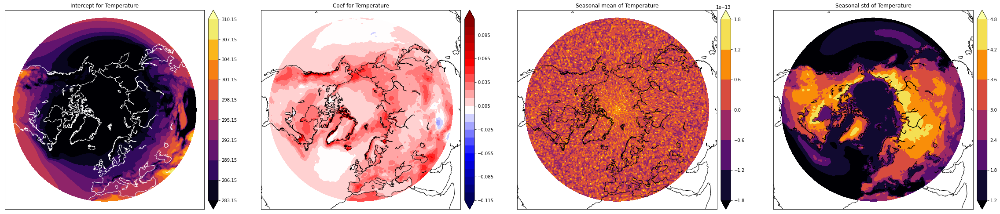

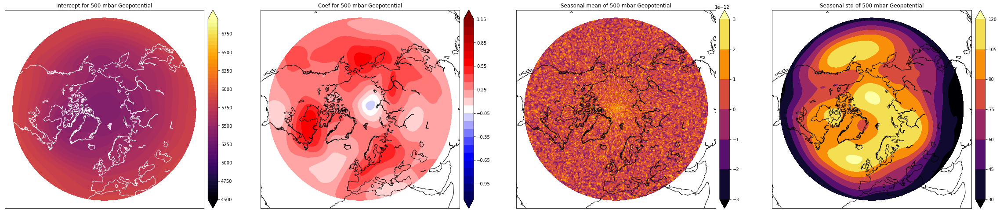

In [13]:
t2m.levels1 = np.arange(10, 40, 3)+K
t2m.levels2 = np.arange(-.12, .12, .01)+.005
zg500.levels1 = zg500.levels
zg500.levels2 = np.arange(-1.2, 1.2, .1)+.05
for myfield in [t2m,zg500]:
    # Plot intercept and the slope for each grid point
    plt.figure(figsize=(40,20))
    plt.subplot(141)
    m = Basemap(projection='nplaea',boundinglat=25,lon_0=0,resolution='c')
    m.contourf(Greenwich(LON),Greenwich(LAT), Greenwich(myfield.intercept),levels=myfield.levels1, cmap=plt.cm.inferno, extend='both', latlon=True) #plt.cm.seismic
    m.colorbar()
    m.drawcoastlines(color="white")
    plt.title('Intercept for '+myfield.label)
    plt.subplot(142)
    m = Basemap(projection='nplaea',boundinglat=25,lon_0=0,resolution='c')
    m.contourf(Greenwich(LON),Greenwich(LAT), Greenwich(myfield.coef),levels=myfield.levels2, cmap=plt.cm.seismic, extend='both', latlon=True) #plt.cm.seismic
    m.colorbar()
    m.drawcoastlines(color="black")
    plt.title('Coef for '+myfield.label)
    plt.subplot(143)
    m = Basemap(projection='nplaea',boundinglat=25,lon_0=0,resolution='c')
    m.contourf(Greenwich(LON),Greenwich(LAT), Greenwich(np.mean(myfield.detr_mean[Tot_Mon1[5]:Tot_Mon1[10]],0)), cmap=plt.cm.inferno, extend='both', latlon=True) #plt.cm.seismic
    m.colorbar()
    m.drawcoastlines(color="black")
    plt.title('Seasonal mean of '+myfield.label)
    plt.subplot(144)
    m = Basemap(projection='nplaea',boundinglat=25,lon_0=0,resolution='c')
    m.contourf(Greenwich(LON),Greenwich(LAT), Greenwich(np.mean(myfield.detr_std[Tot_Mon1[5]:Tot_Mon1[10]],0)), cmap=plt.cm.inferno, extend='both', latlon=True) #plt.cm.seismic
    m.colorbar()
    m.drawcoastlines(color="black")
    plt.title('Seasonal std of '+myfield.label)

In [14]:
t2m.abs_detr_area_int, t2m.ano_detr_area_int = t2m.Set_detr_area_integral(area,mask)
zg500.abs_detr_area_int, zg500.ano_detr_area_int =zg500.Set_detr_area_integral(area,mask)

temp.shape =  (2201,)
temp.shape =  (2130,)
temp.shape =  (2201,)
temp.shape =  (2201,)
temp.shape =  (2201,)
temp.shape =  (2130,)
temp.shape =  (2201,)
temp.shape =  (2201,)
temp.shape =  (2201,)
temp.shape =  (2130,)
temp.shape =  (2201,)
temp.shape =  (2201,)
temp.shape =  (2201,)
temp.shape =  (2130,)
temp.shape =  (2201,)
temp.shape =  (2201,)


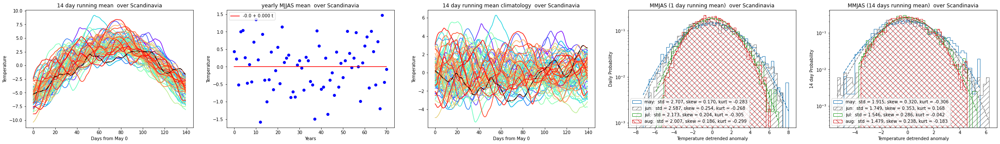

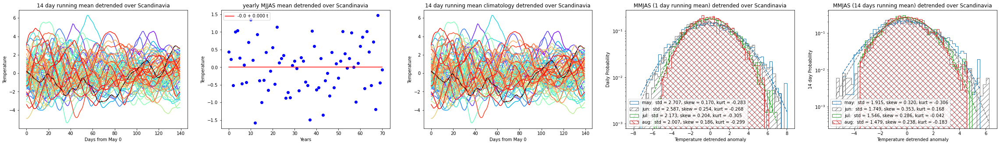

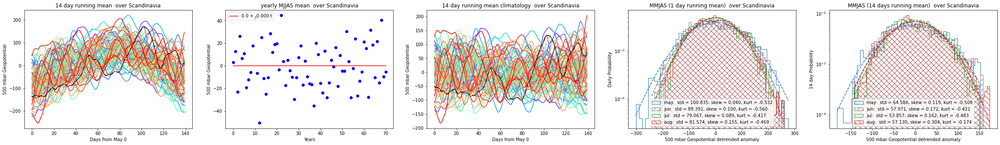

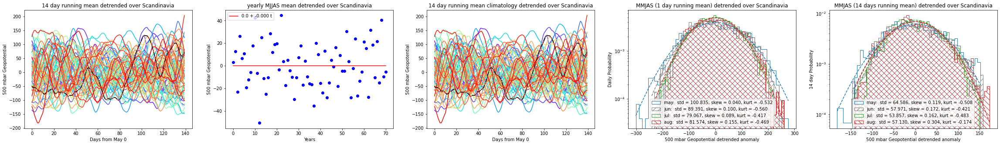

In [15]:
from scipy.stats import skew, kurtosis

mycolors = ["tab:blue", "tab:gray", "tab:green", "tab:red", "tab:purple"]   # these colors are used to distinguish the months
monthhatches = ["","//","","\\\\",""]
mymonth = ["may", "jun", "jul", "aug", "sep"]
mylinewidth = [1, 1, 1, 1, 1]    # summer months should be more visible

field_labels = ['Temperature (C)','Soil Moisture (m)','Geopotential (m)']

for myfield in [t2m,zg500]:
    # Extract the field at a given pixel
    field_extract = []
    for y in range(myfield.var.shape[0]):
        field_extract.append(myfield.detrended[y,:,mylat_pixel,mylon_pixel])
    field_extract = np.array(field_extract)
    field_extract = field_extract[:,Tot_Mon1[5]:Tot_Mon1[10]]
    for j in range(2):
        figlabels = [151,152,153,154,155]
        if j == 0:
            objct = " over "+area
            field_extract = myfield.abs_detr_area_int[:,Tot_Mon1[5]:Tot_Mon1[10]]
        if j == 1:
            field_extract = myfield.ano_detr_area_int[:,Tot_Mon1[5]:Tot_Mon1[10]]
            objct = "detrended over "+area
        ano = []
        ano_conv = []
        for y in range(myfield.var.shape[0]):
            ano.append(field_extract[y,:] - np.mean(field_extract,0))
            ano_conv.append(np.convolve(ano[y], np.ones(14)/14, mode = 'valid'))
        ano = np.array(ano)
        ano_conv = np.array(ano_conv)
        plt.figure(figsize=(40,5))

        color_idx = np.linspace(0, 1, myfield.var.shape[0])
        plt.subplot(figlabels[0])
        summ_mean = []
        for y in range(myfield.var.shape[0]):
            plt.plot(np.convolve(field_extract[y], np.ones(14)/14, mode='valid'),color=plt.cm.rainbow(color_idx[y]))
            summ_mean.append(np.mean(field_extract[y,:]))
        y = 2015 - myfield.start_year
        plt.plot(np.convolve(field_extract[y], np.ones(14)/14, mode='valid'),'k-.')
        summ_mean = np.array(summ_mean)
        plt.title('14 day running mean '+objct)
        plt.xlabel('Days from May 0')
        plt.ylabel(myfield.label)
        X = (np.array(range(myfield.start_year,myfield.start_year+myfield.var.shape[0]))-myfield.start_year).reshape((-1, 1))
        model = LinearRegression().fit(X, summ_mean)
        plt.subplot(figlabels[1])
        plt.plot(X,summ_mean,'bo')
        plt.plot(X,model.predict(X),'r',label='%3.1f + %3.3f t'%(model.intercept_,model.coef_))
        plt.title('yearly MJJAS mean ' +objct )
        plt.xlabel('Years')
        plt.ylabel(myfield.label)
        plt.legend(loc = 'upper left')
        plt.subplot(figlabels[2])

        for y in range(myfield.var.shape[0]):
            plt.plot(ano_conv[y,:],color=plt.cm.rainbow(color_idx[y]))
        y = 2015 - myfield.start_year
        plt.plot(ano_conv[y,:],'k-.')
        plt.title('14 day running mean climatology '+objct)
        plt.xlabel('Days from May 0')
        plt.ylabel(myfield.label)
        plt.subplot(figlabels[3])
        for i in range(4):
            #temp = myfield.ano_mask[:,Tot_Mon1[5+i]:Tot_Mon1[6+i]].reshape(40*(Tot_Mon1[6+i]-Tot_Mon1[5+i]))
            temp = ano[:,Tot_Mon1[5+i]-Tot_Mon1[5]:Tot_Mon1[6+i]-Tot_Mon1[5]].reshape(myfield.var.shape[0]*(Tot_Mon1[6+i]-Tot_Mon1[5+i]))
            print("temp.shape = ",temp.shape)
            n, bins, patches = plt.hist(temp, 50, density = True, histtype = 'step', color = mycolors[i], hatch = monthhatches[i], alpha=1,label = 
                 r"{:s}:  std = {:1.3f}, skew = {:1.3f}, kurt = {:1.3f}".format( mymonth[i],np.std(temp),skew(temp),kurtosis(temp, fisher=True)), linewidth = mylinewidth[i])
            plt.plot(bins,np.exp(-bins**2/(2*np.std(temp)**2))/(np.std(temp)*np.sqrt(2*np.pi)),color = mycolors[i],linestyle='dashed')
        plt.yscale("log")
        plt.xlabel(myfield.label+' detrended anomaly')
        plt.ylabel('Daily Probability')
        plt.title('MMJAS (1 day running mean) '+objct)
        plt.legend(loc = 'best')
        plt.subplot(figlabels[4])

        for i in range(4):
            #ano_mask_running = np.zeros((40,(Tot_Mon1[6+i]-Tot_Mon1[5+i])))
            #for y in range(40):
            #    ano_mask_running[y,:] = np.convolve(myfield.ano_mask[y,Tot_Mon1[5+i]:(Tot_Mon1[6+i]+14 - 1)],  np.ones(14)/14, mode='valid')
            #temp = ano_mask_running.reshape(40*(Tot_Mon1[6+i]-Tot_Mon1[5+i]))
            temp = ano_conv[:,Tot_Mon1[5+i]-Tot_Mon1[5]:Tot_Mon1[6+i]-Tot_Mon1[5]].reshape(myfield.var.shape[0]*(Tot_Mon1[6+i]-Tot_Mon1[5+i]))
            n, bins, patches = plt.hist(temp, 50, density = True, histtype = 'step', color = mycolors[i], hatch = monthhatches[i], alpha=1,label = 
                 r"{:s}:  std = {:1.3f}, skew = {:1.3f}, kurt = {:1.3f}".format( mymonth[i],np.std(temp),skew(temp),kurtosis(temp, fisher=True)), linewidth = mylinewidth[i])
            plt.plot(bins,np.exp(-bins**2/(2*np.std(temp)**2))/(np.std(temp)*np.sqrt(2*np.pi)),color = mycolors[i],linestyle='dashed')
        plt.yscale("log")
        plt.xlabel(myfield.label+' detrended anomaly')
        plt.ylabel('14 day Probability')
        plt.title('MMJAS (14 days running mean) '+objct)
        plt.legend(loc = 'best')

(1000, 150)
(71, 137)
(9727,)
(1000, 153)
(71, 140)
(9940,)
(71, 153)
(71, 140)
(9940,)


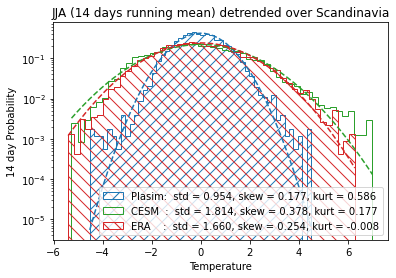

In [16]:
fig = plt.figure(figsize=(6, 4))
mycolors = ["tab:blue", "tab:green", "tab:red"]   # these colors are used to distinguish the months
monthhatches = ["//"," ","\\\\"]
mymonth = ["Plasim", "CESM  ", "ERA    "]
mylinewidth = [1, 1, 1]    # summer months should be more visible

ERA_t2m = t2m.ano_detr_area_int[:,Tot_Mon1[5]:Tot_Mon1[10]]
Plasim_t2m = np.load('../PLASIM/Postproc/Plasim_'+area+'_t2m.npy')
CESM_t2m = np.load('../CESM/Postproc/CESM_'+area+'_t2m.npy')
T = 14
i = 0
for myseries in [Plasim_t2m, CESM_t2m, ERA_t2m]:
    print(myseries.shape)
    ano_conv = []
    for y in range(myfield.var.shape[0]):
        ano_conv.append(np.convolve(myseries[y], np.ones(T)/T, mode = 'valid'))
    ano_conv = np.array(ano_conv)
    print(ano_conv.shape)
    temp = ano_conv.reshape(ano_conv.shape[0]*ano_conv.shape[1])
    print(temp.shape)
    n, bins, patches = plt.hist(temp, 50, density = True, histtype = 'step', color = mycolors[i], hatch = monthhatches[i], alpha=1,label = 
         r"{:s}:  std = {:1.3f}, skew = {:1.3f}, kurt = {:1.3f}".format( mymonth[i],np.std(temp),skew(temp),kurtosis(temp, fisher=True)), linewidth = mylinewidth[i])
    plt.plot(bins,np.exp(-bins**2/(2*np.std(temp)**2))/(np.std(temp)*np.sqrt(2*np.pi)),color = mycolors[i],linestyle='dashed')
    i += 1
plt.yscale("log")
plt.xlabel(t2m.label)
plt.ylabel(str(T)+' day Probability')
plt.title('JJA ('+str(T)+' days running mean) '+objct)
plt.legend(loc = 'best')
fig.savefig("Images/distribution_"+area+".png")

In [17]:
print(t2m.fit_time[0,Tot_Mon1[5]:Tot_Mon1[10] + 1])   # The choice of the domain is not perfectly symmetric since it lacks +1 that we add here which probably contributes to the tiny uncertainty in the detrended fit which should exactly horizontal

[-0.20958904 -0.20684932 -0.20410959 -0.20136986 -0.19863014 -0.19589041
 -0.19315068 -0.19041096 -0.18767123 -0.18493151 -0.18219178 -0.17945205
 -0.17671233 -0.1739726  -0.17123288 -0.16849315 -0.16575342 -0.1630137
 -0.16027397 -0.15753425 -0.15479452 -0.15205479 -0.14931507 -0.14657534
 -0.14383562 -0.14109589 -0.13835616 -0.13561644 -0.13287671 -0.13013699
 -0.12739726 -0.12465753 -0.12191781 -0.11917808 -0.11643836 -0.11369863
 -0.1109589  -0.10821918 -0.10547945 -0.10273973 -0.1        -0.09726027
 -0.09452055 -0.09178082 -0.0890411  -0.08630137 -0.08356164 -0.08082192
 -0.07808219 -0.07534247 -0.07260274 -0.06986301 -0.06712329 -0.06438356
 -0.06164384 -0.05890411 -0.05616438 -0.05342466 -0.05068493 -0.04794521
 -0.04520548 -0.04246575 -0.03972603 -0.0369863  -0.03424658 -0.03150685
 -0.02876712 -0.0260274  -0.02328767 -0.02054795 -0.01780822 -0.01506849
 -0.01232877 -0.00958904 -0.00684932 -0.00410959 -0.00136986  0.00136986
  0.00410959  0.00684932  0.00958904  0.01232877  0.

A.shape =  (71, 79)
np.std(A) =  1.5988885679659486
78 76


/ClimateDynamics/MediumSpace/ClimateLearningFR/gmiloshe/ERA/ERA_Fields.py:792: UserWarning: a_max_and_ti_postproc: adjusting length
  warnings.warn('a_max_and_ti_postproc: adjusting length')
/ClimateDynamics/MediumSpace/ClimateLearningFR/gmiloshe/ERA/ERA_Fields.py:764: RuntimeWarning: divide by zero encountered in log
  r1 = - 1/(np.log(1 - m/len(D_sorted))) # assumption of Poisson process


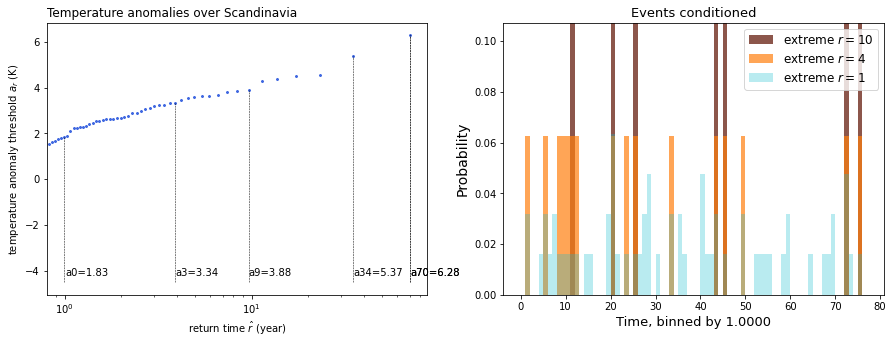

In [18]:
A = np.zeros((t2m.var.shape[0], Tot_Mon1[9] - Tot_Mon1[6] - 13))   # When we use convolve (running mean) there is an extra point that we can generate by displacing the window hence 13 instead of 14
convseq = np.ones(14)/14
for y in range(t2m.var.shape[0]):
    A[y,:]=np.convolve(t2m.ano_detr_area_int[y,(Tot_Mon1[6]):(Tot_Mon1[9])],  convseq, mode='valid')
print("A.shape = ", A.shape)
print("np.std(A) = ",np.std(A))
A_max, Ti, year_a = a_max_and_ti_postproc(A, A.shape[1])
year_a = range(t2m.var.shape[0])
A_max_sorted = a_decrese(A_max, Ti, year_a)
XX_rt, YY_rt, xx_rt, yy_rt = return_time_fix(A_max_sorted,'yes')
print(np.max(Ti),90-14)
figure = plt.figure(1, figsize=(15, 5))
ax1 = figure.add_subplot(121)
Ax = figure.add_subplot(122)
PltReturnsHist(XX_rt, YY_rt, xx_rt, yy_rt, A_max_sorted, Tot_Mon1,area,ax1,Ax)

A.shape =  (71, 88)
A.shape =  (71, 79)
A.shape =  (71, 63)
A.shape =  (71, 3)


Text(0.0, 1.0, 'Temperature anomalies over Scandinavia')

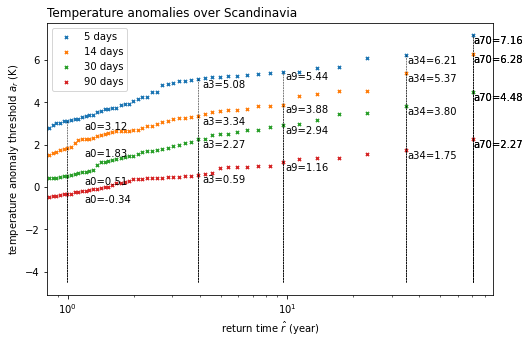

In [19]:
figure = plt.figure(1, figsize=(8, 5))
ax = figure.add_subplot(111)

for T in [5,14,30, 90]:
    A = np.zeros((t2m.var.shape[0], Tot_Mon1[9] - Tot_Mon1[6] - T+1))   # When we use convolve (running mean) there is an extra point that we can generate by displacing the window hence 13 instead of 14
    for y in range(t2m.var.shape[0]):
        A[y,:]=np.convolve(t2m.ano_detr_area_int[y,Tot_Mon1[6]:(Tot_Mon1[9])],  np.ones(T)/T, mode='valid')
    print("A.shape = ",A.shape)
    A_max, Ti, year_a = a_max_and_ti_postproc(A, A.shape[1])
    A_max_sorted = a_decrese(A_max, Ti, year_a)
    XX_rt, YY_rt, xx_rt, yy_rt = return_time_fix(A_max_sorted,'yes')
    ax.scatter(XX_rt, YY_rt, s=10, marker='x',label=str(T)+' days')
    np.save('Postproc/ERA_'+area+'_XX_rt_'+str(T),XX_rt)
    np.save('Postproc/ERA_'+area+'_YY_rt_'+str(T),YY_rt)
    for i in range(len(xx_rt)):
        ax.text(xx_rt[i] + 0.2, yy_rt[i]-.4, 'a{}={:.2f}'.format(int(xx_rt[i]), yy_rt[i]))
        ax.plot([xx_rt[i], xx_rt[i]], [-4.5, yy_rt[i]], linestyle='--', color='black', linewidth=0.5)
ax.legend(loc='best')
ax.set_xscale('log')
ax.set_xlabel('return time $\hat{r}$ (year)')
ax.set_ylabel('temperature anomaly threshold $a_r$ (K)')
ax.set_title('Temperature anomalies over '+ area, loc='left')

(92,)


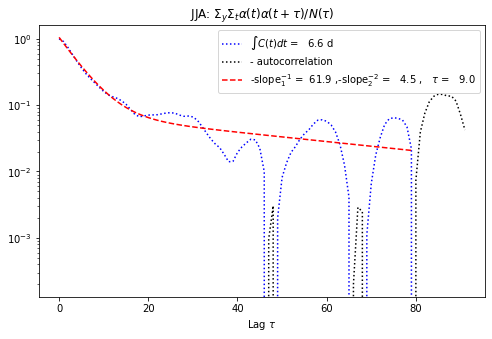

In [20]:
myfirst = [Tot_Mon1[6]]
mylast = [Tot_Mon1[9]]
myperiod_label = ['JJA']
myfiglabels = ['161']

figure = plt.figure(1, figsize=(8, 5))
for first, last, period_label, figlabels in zip(myfirst, mylast, myperiod_label, myfiglabels):

    autocorr = autocorrelation(t2m.ano_detr_area_int[:,first:last],last-first)
    autocorr = np.array(autocorr)/np.std(t2m.ano_detr_area_int[:,first:last])**2
    print(autocorr.shape)
    np.save('Postproc/ERA_'+area+'_auto_corr_'+period_label,autocorr)
    PltAutocorrelationFit(autocorr,autocorr,0,80,ax,period_label)
    plt.legend()
    figure.savefig("Images/autocorelation_"+period_label+"_"+area+".png")

(92,)


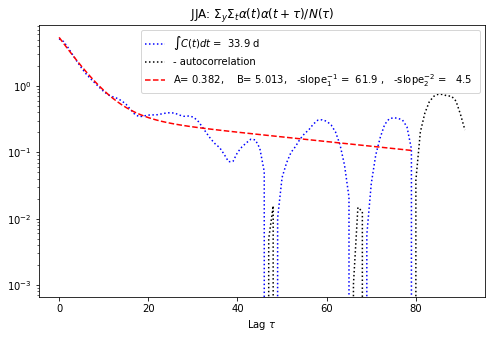

In [21]:
def PltAutocorrelationFit(autocorr_mean,autocorr_std,x1,x2, ax,period_label):
    # Plot normalized Autocorrelation function
    plt.plot(np.arange(0, len(autocorr_mean)), autocorr_mean,'b:', label=r'$\int C(t) dt$ = %5.1f d'%(integrate.cumtrapz(np.array(autocorr_mean), range(len(autocorr_mean)), initial=0)[-1]))
    plt.plot(np.arange(0, len(autocorr_mean)), -autocorr_mean,'k:', label='- autocorrelation')
    
    popt1, pcov1 = curve_fit(func1, np.array(range(x1,x2)), autocorr_mean[x1:x2], p0=(1, 1e-6, 1, 1e-6))
    xaxis1 = np.arange(x1,x2)
    plt.plot(xaxis1, func1(xaxis1, *popt1), 'r--', label=r'A= %5.3f,$\quad$ B= %5.3f,$\quad$-slope$^{-1}_1$ = %5.1f ,$\quad$-slope$^{-2}_2$ = %5.1f  ' %(popt1[0],popt1[2],-popt1[1]**(-1),-popt1[3]**(-1)))

    plt.title(period_label+r": $\Sigma_y \Sigma_t  \alpha(t) \alpha(t+\tau)/N(\tau)$")
    plt.yscale("log")
    plt.xlabel(r"Lag $\tau$")
myfirst = [Tot_Mon1[6]]
mylast = [Tot_Mon1[9]]
myperiod_label = ['JJA']
myfiglabels = ['161']

figure = plt.figure(1, figsize=(8, 5))
for first, last, period_label, figlabels in zip(myfirst, mylast, myperiod_label, myfiglabels):
    autocorr = autocorrelation(t2m.ano_detr_area_int[:,first:last],last-first)
    autocorr = np.array(autocorr)#/np.std(t2m.ano_detr_area_int[:,first:last])**2
    np.save('Postproc/ERA_'+area+'_nonorm_auto_corr_'+period_label,autocorr)
    print(autocorr.shape)
    #np.save('Postproc/ERA_'+area+'_auto_corr_'+period_label,autocorr)
    PltAutocorrelationFit(autocorr,autocorr,0,80,ax,period_label)
    plt.legend()
    #extent = ax.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    #figure.savefig("Images/autocorelation_"+period_label+"_"+area+".png", bbox_inches=extent.expanded(1.3, 1.3))

(92,)


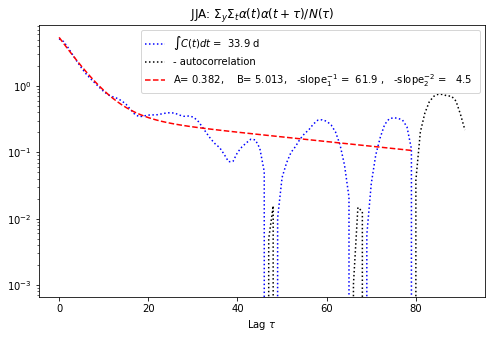

In [22]:
def PltAutocorrelationFit(autocorr_mean,autocorr_std,x1,x2, ax,period_label):
    # Plot normalized Autocorrelation function
    plt.plot(np.arange(0, len(autocorr_mean)), autocorr_mean,'b:', label=r'$\int C(t) dt$ = %5.1f d'%(integrate.cumtrapz(np.array(autocorr_mean), range(len(autocorr_mean)), initial=0)[-1]))
    plt.plot(np.arange(0, len(autocorr_mean)), -autocorr_mean,'k:', label='- autocorrelation')
    
    popt1, pcov1 = curve_fit(func1, np.array(range(x1,x2)), autocorr_mean[x1:x2], p0=(1, 1e-6, 1, 1e-6))
    xaxis1 = np.arange(x1,x2)
    plt.plot(xaxis1, func1(xaxis1, *popt1), 'r--', label=r'A= %5.3f,$\quad$ B= %5.3f,$\quad$-slope$^{-1}_1$ = %5.1f ,$\quad$-slope$^{-2}_2$ = %5.1f  ' %(popt1[0],popt1[2],-popt1[1]**(-1),-popt1[3]**(-1)))

    plt.title(period_label+r": $\Sigma_y \Sigma_t  \alpha(t) \alpha(t+\tau)/N(\tau)$")
    plt.yscale("log")
    plt.xlabel(r"Lag $\tau$")
myfirst = [Tot_Mon1[6]]
mylast = [Tot_Mon1[9]]
myperiod_label = ['JJA']
myfiglabels = ['161']

figure = plt.figure(1, figsize=(8, 5))
for first, last, period_label, figlabels in zip(myfirst, mylast, myperiod_label, myfiglabels):
    autocorr = autocorrelation(t2m.ano_detr_area_int[:,first:last],last-first)
    autocorr = np.array(autocorr)#/np.std(t2m.ano_detr_area_int[:,first:last])**2
    np.save('Postproc/ERA_'+area+'_nonorm_auto_corr_'+period_label,autocorr)
    print(autocorr.shape)
    #np.save('Postproc/ERA_'+area+'_auto_corr_'+period_label,autocorr)
    PltAutocorrelationFit(autocorr,autocorr,0,80,ax,period_label)
    plt.legend()
    #extent = ax.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    #figure.savefig("Images/autocorelation_"+period_label+"_"+area+".png", bbox_inches=extent.expanded(1.3, 1.3))

In [23]:
t2m.detrended.shape

(71, 153, 80, 480)

In [24]:
t2m.detr_mean.shape

(153, 80, 480)

In [25]:
return_index = 1
threshold=3.5
np.save('Postproc/LAT',np.asarray(LAT))
np.save('Postproc/LON',np.asarray(LON))
for T in [14]:
    for myfield in [t2m, zg500]:
        print(myfield.name)
        #CompCompositesERA(t2m.ano_detr_area_int, myfield, T, Tot_Mon1, return_index, myfield.detr_mean)
        CompCompositesERAThreshold(t2m.ano_detr_area_int, myfield, T, Tot_Mon1, threshold, myfield.detr_mean)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_mean_'+str(T),myfield.composite_mean)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_std_'+str(T),myfield.composite_std)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_t_'+str(T),myfield.composite_t)

t2m
A.shape =  (71, 79)
A_max[1] =  3.6408489173080616 Ti[1] =  78
A_max[3] =  5.365739271768044 Ti[3] =  11
A_max[5] =  4.546240541224985 Ti[5] =  75
A_max[7] =  4.277077100332867 Ti[7] =  43
A_max[9] =  3.8848160624400543 Ti[9] =  72
A_max[16] =  3.631476789886892 Ti[16] =  8


/ClimateDynamics/MediumSpace/ClimateLearningFR/gmiloshe/ERA/ERA_Fields.py:792: UserWarning: a_max_and_ti_postproc: adjusting length
  warnings.warn('a_max_and_ti_postproc: adjusting length')


A_max[22] =  6.277185840764029 Ti[22] =  25
A_max[23] =  3.8108247774030413 Ti[23] =  23
A_max[24] =  3.6646843963984037 Ti[24] =  9
A_max[38] =  4.388400730315869 Ti[38] =  20
A_max[42] =  3.8444171512154677 Ti[42] =  1
A_max[53] =  3.6078410919835946 Ti[53] =  49
A_max[68] =  4.515653673898662 Ti[68] =  45
A_max[70] =  3.556259150048526 Ti[70] =  12
number of events:  14
z
A.shape =  (71, 79)
A_max[1] =  3.6408489173080616 Ti[1] =  78
A_max[3] =  5.365739271768044 Ti[3] =  11
A_max[5] =  4.546240541224985 Ti[5] =  75
A_max[7] =  4.277077100332867 Ti[7] =  43
A_max[9] =  3.8848160624400543 Ti[9] =  72
A_max[16] =  3.631476789886892 Ti[16] =  8
A_max[22] =  6.277185840764029 Ti[22] =  25
A_max[23] =  3.8108247774030413 Ti[23] =  23
A_max[24] =  3.6646843963984037 Ti[24] =  9
A_max[38] =  4.388400730315869 Ti[38] =  20
A_max[42] =  3.8444171512154677 Ti[42] =  1
A_max[53] =  3.6078410919835946 Ti[53] =  49
A_max[68] =  4.515653673898662 Ti[68] =  45
A_max[70] =  3.556259150048526 Ti[70]

/tmp/ipykernel_3945188/3845430226.py:14: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')


0


/ClimateDynamics/MediumSpace/ClimateLearningFR/gmiloshe/ERA/ERA_Fields.py:623: UserWarning: No contour levels were found within the data range.
  c_sign = m.contour(Lon, Lat, zg_sign, levels=data_contour_level[:data_contour_level.shape[0]//2], colors=colors[0], linestyles = mylinestyles[0],linewidths=mylinewidths[0], latlon=True)  #negative significant anomalies of geopotential


1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59


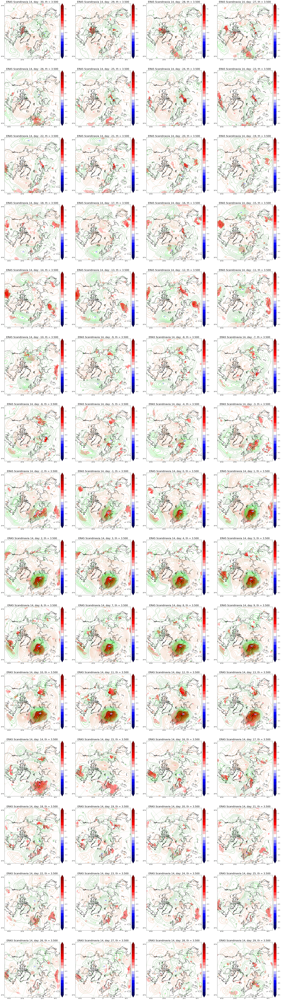

In [26]:
t_value = 2
ts_level = np.linspace(-8.5, 8.5, 18) 
zg_level = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(10, 10 * 21, 10)))
title_frame = area + '_T' + str(T) + '_' + t2m.filename + '_' + zg500.filename

import matplotlib.gridspec as gridspec
fig2 = plt.figure(figsize=(40, 150))

spec2 = gridspec.GridSpec(ncols=4, nrows=15, figure=fig2)
Nb_frame = 60
for j in range(15):
    for i in range(4):
        ax = fig2.add_subplot(spec2[j,i])
        m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
        myindex = (i+4*j)
        title_frame = Model+" "+area+" "+str(T)
        print(myindex)
        if myindex < Nb_frame:
            temp_sign, ts_taken = significative_data(t2m.composite_mean[myindex,:,:], t2m.composite_t[myindex,:,:], t_value, False)
            geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', th = %1.3f'%(threshold)) #r = %1.3f'%(xx_rt[return_index]))
            geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.composite_mean[myindex,:,:]), Greenwich(zg500.composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
            PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.composite_mean[myindex,:,:]))
            #fig2.savefig("Images/"+Model+"_north_"+area+"_"+str(T)+"_"+str(xx_rt[return_index])+"_"+str((i+4*j)-30)+".png", bbox_inches=full_extent(ax,.25).transformed(fig2.dpi_scale_trans.inverted()))
            fig2.savefig("Images/"+Model+"_north_"+area+"_"+str(T)+"_"+str(threshold)+"_"+str((i+4*j)-30)+".png", bbox_inches=full_extent(ax,.25).transformed(fig2.dpi_scale_trans.inverted()))
#fig2.savefig("Images/CESM_"+area+"_composites.png")

In [30]:
t2m.detrended.shape, Tot_Mon1[7]

((71, 153, 80, 480), 61)

In [45]:
lsm[lat_start:lat_end,lon_start:lon_end].shape

(80, 480)

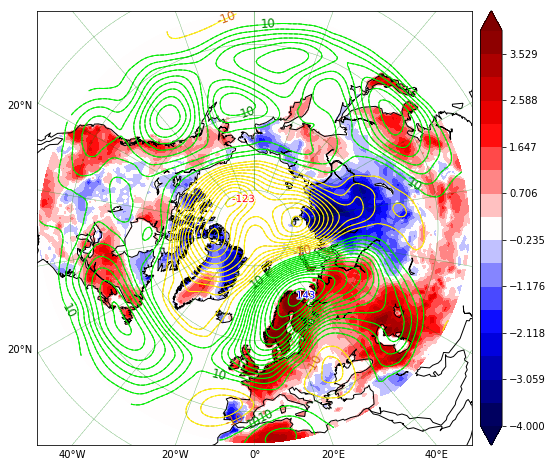

In [46]:
y = 2018-t2m.start_year

t2m.levels = np.linspace(-4, 4, 18)  # Levels to be used when plotting
#zg500.levels = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(10, 10 * 21, 10))) 
zg500.levels = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(10, 10 * 21, 10))) 
fig2 = plt.figure(figsize=(10, 8))
ax = fig2.add_subplot(1, 1, 1)
i = range(Tot_Mon1[7],Tot_Mon1[8])
t2m.temp = lsm[lat_start:lat_end,lon_start:lon_end]*np.mean(t2m.detrended[y,i,:,:] - t2m.detr_mean[i,:,:],0)
zg500.temp = np.mean(zg500.detrended[y,i,:,:] - zg500.detr_mean[i,:,:],0)
m = Basemap(projection='nplaea',boundinglat=30,lon_0=0,resolution='c')
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(t2m.temp), t2m.levels, "seismic", '')
geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.temp), Greenwich(3*np.ones(zg500.temp.shape)), zg_level, ["yellow","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.temp))
fig2.savefig("Images/detrended_july_2018.png")

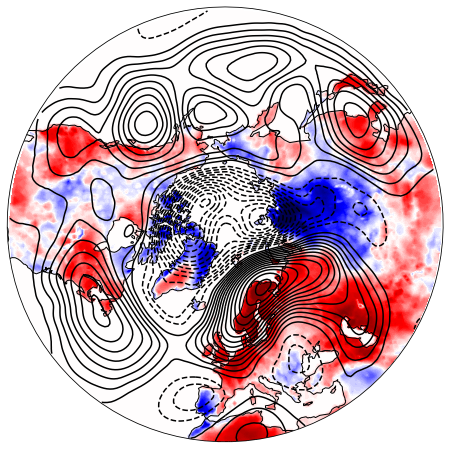

In [51]:
#!/usr/bin/env python3.7

#import sys
#from shutil import copy
#import numpy as np
#import math
#from netCDF4 import Dataset
#import subprocess
#import matplotlib.pyplot as plt
#from matplotlib import cm
#import matplotlib.ticker as mticker
#import pickle
import cartopy.crs as ccrs
from cartopy.util import add_cyclic_point
import matplotlib.path as mpath
t2mlevels = np.linspace(-4, 4, 100)

#data=ncfile
#datacm=data to be plotted in color map
#datacl=data to be plotted in contour lines
datacm_cyclic, lon_cyclic = add_cyclic_point(t2m.temp, coord=lon)
datacl_cyclic, lon_cyclic = add_cyclic_point(zg500.temp, coord=lon)
lons = LON
lats = LAT
lons_cyclic, lats_cyclic = np.meshgrid(lon_cyclic,lat)

nlon=288


#lons=np.concatenate((lons[:,int(nlon/2):nlon+1]-360.0,lons[:,0:int(nlon/2)]),axis=1)
#lats=np.concatenate((lats[:,int(nlon/2):nlon+1],lats[:,0:int(nlon/2)]),axis=1)

fig=plt.figure(figsize=(10, 8))
ax = plt.axes(projection=ccrs.NorthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)

plt.contourf(lons_cyclic, lats_cyclic, np.clip(datacm_cyclic, -4, 4), levels=t2mlevels, cmap='seismic',transform=ccrs.PlateCarree())
#cb=plt.colorbar(ax=ax,ticks=t2m.levels,orientation="horizontal",shrink=0.5); cb.ax.tick_params(labelsize=6) #cb.ax.tick_params(labelsize='smaller')
plt.contour(lons_cyclic, lats_cyclic, datacl_cyclic, levels=zg_level,colors='k',linewidths=1.5,transform=ccrs.PlateCarree())
ax.set_extent([-180, 180, 30, 90], crs=ccrs.PlateCarree())
ax.coastlines(linewidth=1)

fig.savefig("Images/detrended_july_2018.png", bbox_inches='tight') 

mylon =  3.75 , mylat =  78.75 , mylon_coor =  2861704.008667081 , mylat_coor =  5128652.24542266
88
90
92
94


<Figure size 2880x2880 with 0 Axes>

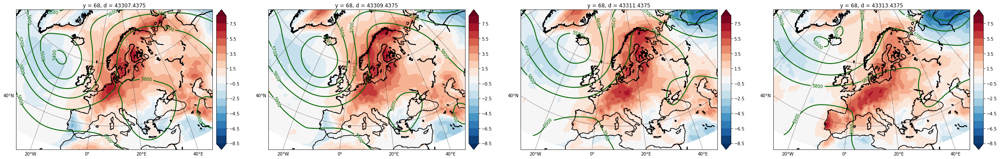

In [12]:
y = 2018-t2m.start_year
mylon_pixel = 5
mylat_pixel = 15
mylon = LON[mylat_pixel, mylon_pixel]
mylat = LAT[mylat_pixel, mylon_pixel]
mylon_coor, mylat_coor = m(mylon, mylat)
print("mylon = ",mylon,", mylat = ",mylat, ", mylon_coor = ",mylon_coor, ", mylat_coor = ", mylat_coor)

t2m.levels = np.linspace(-8.5, 8.5, 18)  # Levels to be used when plotting
#zg500.levels = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(10, 10 * 21, 10))) 
zg500.levels = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(5000, 6000, 100))) 
fig2 = plt.figure(figsize=(40, 40))
spec2 = gridspec.GridSpec(ncols=4, nrows=1, figure=fig2)
iterate = 0
ax = []
fig2 = plt.figure(figsize=(40, 10))
for i,subplt in zip([Tot_Mon1[8] - 4, Tot_Mon1[8]-2,Tot_Mon1[8],Tot_Mon1[8]+2],['141','142','143','144']):
    ax.append(fig2.add_subplot(spec2[0,iterate]))
    iterate = iterate + 1
    print(i)
    #m = Basemap(projection='nplaea',boundinglat=30,lon_0=0,resolution='c')
    m = Basemap(width=7000000,height=5000000,
            resolution='l',projection='laea',\
            lat_ts=70,lat_0=55,lon_0=10.)
    #anomaly_animate(m, ax[iterate-1], 0, Greenwich(LON), Greenwich(LAT), Greenwich(t2m.detrended[y,i,:,:]-t2m.detr_mean[i,:,:]), t2m.levels, Greenwich(zg500.detrended[y,i,:,:]-zg500.detr_mean[i,:,:]), zg500.levels, "RdBu_r", "temperature  and geopotential, at y = " + str(y)+", d = "+str(t2m.time[y,i]))
    anomaly_absolute_animate(m, ax[iterate-1], 0, Greenwich(LON), Greenwich(LAT), Greenwich(np.mean(t2m.detrended[y,i-3:i+3,:,:]-t2m.detr_mean[i-3:i+3,:,:],0)), t2m.levels, Greenwich(np.mean(zg500.var[y,i-3:i+3,:,:],0)), zg500.levels, "RdBu_r", "y = " + str(y)+", d = "+str(t2m.time[y,i]))

70
72
74
76


<Figure size 2880x2880 with 0 Axes>

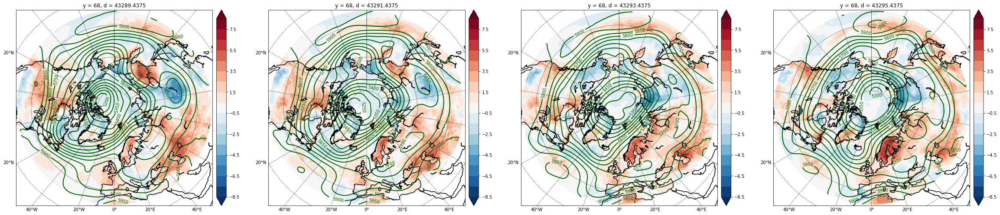

In [36]:
fig2 = plt.figure(figsize=(40, 40))
spec2 = gridspec.GridSpec(ncols=4, nrows=1, figure=fig2)
iterate = 0
ax = []
fig2 = plt.figure(figsize=(40, 10))
zg500.levels = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(5000, 6000, 50))) 
for i,subplt in zip([Tot_Mon1[7] + 9, Tot_Mon1[7] + 11,Tot_Mon1[7] + 13,Tot_Mon1[7]+15],['141','142','143','144']):
    ax.append(fig2.add_subplot(spec2[0,iterate]))
    iterate = iterate + 1
    print(i)
    m = Basemap(projection='nplaea',boundinglat=30,lon_0=0,resolution='c')
    #anomaly_animate(m, ax[iterate-1], 0, Greenwich(LON), Greenwich(LAT), Greenwich(t2m.detrended[y,i,:,:]-t2m.detr_mean[i,:,:]), t2m.levels, Greenwich(zg500.detrended[y,i,:,:]-zg500.detr_mean[i,:,:]), zg500.levels, "RdBu_r", "temperature  and geopotential, at y = " + str(y)+", d = "+str(t2m.time[y,i]))
    anomaly_absolute_animate(m, ax[iterate-1], 0, Greenwich(LON), Greenwich(LAT), Greenwich(np.mean(t2m.detrended[y,i-3:i+3,:,:]-t2m.detr_mean[i-3:i+3,:,:],0)), t2m.levels, Greenwich(np.mean(zg500.var[y,i-3:i+3,:,:],0)), zg500.levels, "RdBu_r", "y = " + str(y)+", d = "+str(t2m.time[y,i]))

In [37]:
t2m.detrended[:,Tot_Mon1[6]:Tot_Mon1[9],:,:].shape

(71, 92, 80, 480)

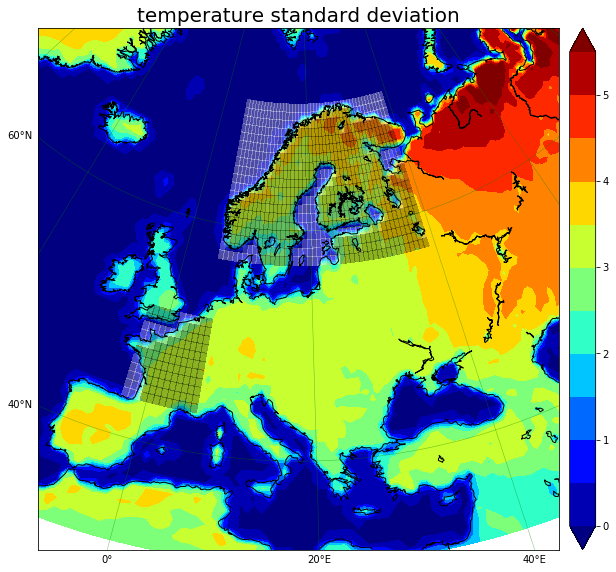

In [38]:
area = 'Scandinavia'
LON_mask = create_mask(Model,area,LON)
LAT_mask = create_mask(Model,area,LAT)
fig = plt.figure(figsize=(10, 10))
ax = plt.subplot(111)
coords2 = [55, 18., 5000000, 5000000]
t2mshape = t2m.detrended[:,Tot_Mon1[6]:Tot_Mon1[9],:,:].shape
m = Basemap(width=coords2[2],height=coords2[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords2[0],lon_0=coords2[1])
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(lsm[lat_start:lat_end,lon_start:lon_end]*np.std(t2m.detrended[:,Tot_Mon1[6]:Tot_Mon1[9],:,:].reshape(t2mshape[0]*t2mshape[1],t2mshape[2],t2mshape[3]),0)), np.arange(0,6,.5), "jet", "temperature standard deviation")
m.pcolormesh((LON_mask), (LAT_mask), (create_mask(Model,area,lsm)), latlon=True, alpha = .3, cmap='binary')
area2 = 'France'
LON_mask2 = create_mask(Model,area2,LON)
LAT_mask2 = create_mask(Model,area2,LAT)
m.pcolormesh((LON_mask2), (LAT_mask2), (create_mask(Model,area2,lsm)), latlon=True, alpha = .3, cmap='binary')
fig.savefig("Images/"+Model+"t2m_std.png")

72
3.5013457887808235


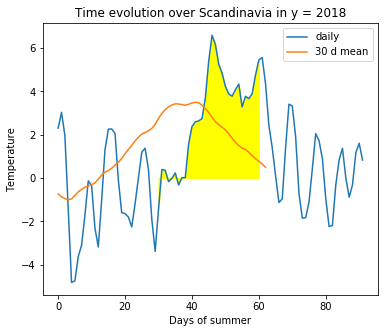

In [39]:
fig = plt.figure(figsize=(6, 5))
T=30
for myfield in [t2m]:
    y = 2018 - myfield.start_year
    field_extract = myfield.ano_detr_area_int[:,Tot_Mon1[6]:Tot_Mon1[9]]
    #onset_heatwave = np.argmax(field_extract[])
    objct = "over "+area
    plt.subplot(111)
    plt.fill_between(np.arange(Tot_Mon1[7]-Tot_Mon1[6], Tot_Mon1[8]-Tot_Mon1[6]), np.zeros(np.arange(Tot_Mon1[7]-Tot_Mon1[6], Tot_Mon1[8]-Tot_Mon1[6]).shape), field_extract[y,(Tot_Mon1[7]-Tot_Mon1[6]):(Tot_Mon1[8]-Tot_Mon1[6])],color='yellow')
    plt.plot(field_extract[y],label = 'daily')
    time_avg_field_extract = np.convolve(field_extract[y], np.ones(T)/T, mode='valid')
    print(np.argmax(time_avg_field_extract)+Tot_Mon1[6])
    plt.plot(time_avg_field_extract,label = str(T)+' d mean')
    plt.title('Time evolution '+objct+' in y = '+str(y+myfield.start_year))
    plt.xlabel('Days of summer')
    plt.ylabel(myfield.label)
    plt.legend(loc='best')
    print(np.max(time_avg_field_extract[Tot_Mon1[6]:Tot_Mon1[9]]))
    fig.savefig("Images/detrended_t2m_timeseries_"+area+".png")

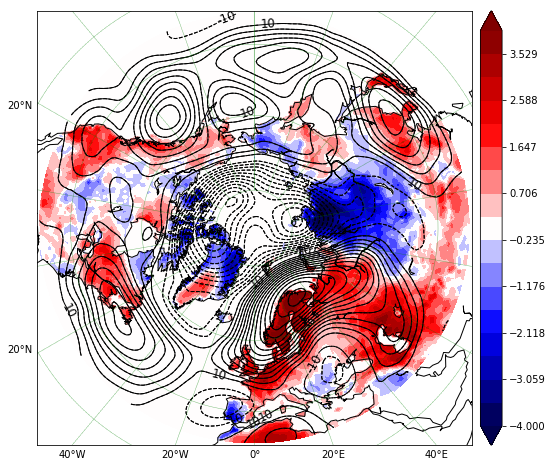

In [40]:
y = 2018-t2m.start_year

t2m.levels = np.linspace(-4, 4, 18)  # Levels to be used when plotting
#zg500.levels = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(10, 10 * 21, 10))) 
zg500.levels = np.concatenate((np.arange(-10 * 20, 0, 10),  np.arange(10, 10 * 21, 10))) 
fig2 = plt.figure(figsize=(10, 8))
ax = fig2.add_subplot(1, 1, 1)

#i = range(np.argmax(time_avg_field_extract)+Tot_Mon1[6],np.argmax(time_avg_field_extract)+30+Tot_Mon1[6])
i = range(Tot_Mon1[7],Tot_Mon1[8])
t2m.temp = lsm[lat_start:lat_end,lon_start:lon_end]*np.mean(t2m.detrended[y,i,:,:] - t2m.detr_mean[i,:,:],0)
zg500.temp = np.mean(zg500.detrended[y,i,:,:] - zg500.detr_mean[i,:,:],0)
m = Basemap(projection='nplaea',boundinglat=30,lon_0=0,resolution='c')
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(t2m.temp), t2m.levels, "seismic", '')
geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.temp), Greenwich(3*np.ones(zg500.temp.shape)), zg500.levels, ["black","black","black","black"],["dashed","dashed","dashed","solid"],[1,1,1,1])
#PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.temp))
#fig2.savefig("Images/detrended_july_2018.png")

In [41]:
np.argmax(time_avg_field_extract)

41

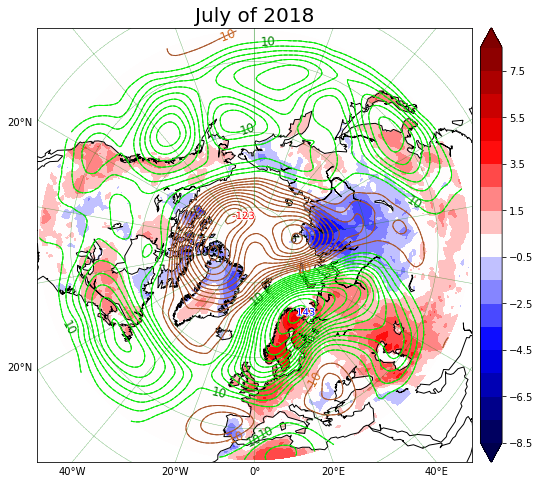

In [42]:
y = 2018-t2m.start_year
t_value = 0
t2m.levels = np.linspace(-8.5, 8.5, 18)  # Levels to be used when plotting
#zg500.levels = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(10, 10 * 21, 10))) 
zg500.levels = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(5000, 6000, 100))) 
fig2 = plt.figure(figsize=(10, 8))
ax = fig2.add_subplot(1, 1, 1)
#i = range(np.argmax(time_avg_field_extract)+Tot_Mon1[6],np.argmax(time_avg_field_extract)+30+Tot_Mon1[6])
i = range(Tot_Mon1[7],Tot_Mon1[8])

for myfield in [t2m, zg500]:
    myfield.temp = np.mean(myfield.detrended[y,i,:,:] - myfield.detr_mean[i,:,:],0)
    myfield.temp_std = np.std(myfield.detrended[y,i,:,:] - myfield.detr_mean[i,:,:],0)
    nb_events = myfield.temp.shape[0]
    myfield.temp_t = (lambda a, b: np.divide(a, b, out=np.zeros(a.shape), where=b != 0))(np.sqrt(nb_events) * myfield.temp, myfield.temp_std)

m = Basemap(projection='nplaea',boundinglat=30,lon_0=0,resolution='c')


temp_sign, ts_taken = significative_data(t2m.temp, t2m.temp_t[:,:], t_value, False)
temp_sign = lsm[lat_start:lat_end,lon_start:lon_end]*temp_sign
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(temp_sign), ts_level, "seismic", 'July of '+str(y+t2m.start_year) )
geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.temp[:,:]), Greenwich(zg500.temp_t[:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.temp[:,:]))
fig2.savefig("Images/detrended_july_2018_2.png")